<a href="https://colab.research.google.com/github/PulseProgrammer/Digital_Dreams/blob/main/Digital_Dreams.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#@title Packages for Music Generation
import glob
import pickle
import ipywidgets as widgets
from IPython.core.display import clear_output
from music21 import converter, instrument, note, chord
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Dropout
from keras.layers import LSTM
from keras.layers import Activation
from keras.layers import BatchNormalization as BatchNorm
from keras.utils import np_utils
from keras.callbacks import ModelCheckpoint
from music21 import tempo
import numpy as np
from music21 import stream
import os
from tensorflow.keras.callbacks import History
import matplotlib.pyplot as plt



In [ ]:
#directories to store model checkpoints and data preprocessing
os.makedirs("data")
os.makedirs("music_cp")
os.makedirs("name_cp")

Music Generative Model
Reference: https://github.com/Skuldur/Classical-Piano-Composer

In [ ]:
def get_notes():

  '''Extract musical notes from MIDI files '''
  notes = []

  for file in glob.glob("/content/drive/MyDrive/Dataset/MIDI_Music/*.mid"):
      midi = converter.parse(file)

      print("Parsing %s" % file)

      notes_to_parse = None

      try: # file has instrument parts
          s2 = instrument.partitionByInstrument(midi)
          notes_to_parse = s2.parts[0].recurse() 
      except: # file has notes in a flat structure
          notes_to_parse = midi.flat.notes

      for element in notes_to_parse:
          if isinstance(element, note.Note):
              notes.append(str(element.pitch))
          elif isinstance(element, chord.Chord):
              notes.append('.'.join(str(n) for n in element.normalOrder))

  with open('data/notes.pkl', 'wb') as filepath:
      pickle.dump(notes, filepath)

  return notes

In [ ]:
def prepare_sequences(notes, n_vocab):

  ''' Creating input data and target output for the model '''

  sequence_length = 16

  # get all pitch names
  pitchnames = sorted(set(item for item in notes))

  # create a dictionary to map pitches to integers
  note_to_int = dict((note, number) for number, note in enumerate(pitchnames))

  network_input = []
  network_output = []

  # create input sequences and the corresponding outputs
  for i in range(0, len(notes) - sequence_length, 1):
      sequence_in = notes[i:i + sequence_length]
      sequence_out = notes[i + sequence_length]
      network_input.append([note_to_int[char] for char in sequence_in])
      network_output.append(note_to_int[sequence_out])

  n_patterns = len(network_input)

  # reshape the input into a format compatible with LSTM layers
  network_input = np.reshape(network_input, (n_patterns, sequence_length, 1))
  # normalize input
  network_input = network_input / float(n_vocab)

  network_output = np_utils.to_categorical(network_output)

  return (network_input, network_output)

In [ ]:
def create_network(network_input, n_vocab):
  ''' Create model architecture ''' 

  model = Sequential()
  model.add(LSTM(
      512,
      input_shape=(network_input.shape[1], network_input.shape[2]),
      recurrent_dropout=0.2,
      return_sequences=True
  ))
  model.add(LSTM(512, return_sequences=True, recurrent_dropout=0.2,)) #dropout parameter changed from reference
  model.add(LSTM(512))
  model.add(BatchNorm())
  model.add(Dropout(0.2))
  model.add(Dense(256))
  model.add(Activation('relu'))
  model.add(BatchNorm())
  model.add(Dropout(0.2))
  model.add(Dense(n_vocab))
  model.add(Activation('softmax'))
  model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy']) #Adam optimiser is used instead of rmsprop and Accuracy metrics used for evaluation

  return model

In [ ]:
def train(model, network_input, network_output):
    """ train the neural network """
    checkpoint_dir = "/content/music_cp"
    filepath =  os.path.join(checkpoint_dir,"{epoch}-{loss:.4f}.hdf5")
    checkpoint = ModelCheckpoint(
        filepath,
        monitor='loss',
        verbose=0,
        save_best_only=False,  # Save weights at the end of each epoch
        save_freq='epoch'      # Save weights at the end of each epoch
    )
    callbacks_list = [checkpoint]

    history = model.fit(network_input, network_output, epochs=120, batch_size=64, callbacks=callbacks_list)

    # Create two subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 10))

    # Plot training loss and validation loss in the first subplot
    ax1.plot(history.history['loss'], linestyle='-', color='steelblue', linewidth=2, label='Train Loss')
    ax1.set_title('Model Loss')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.legend()

    # Plot training accuracy and validation accuracy in the second subplot
    ax2.plot(history.history['accuracy'], linestyle='--', color='green', linewidth=2, label='Train Accuracy')
    ax2.set_title('Model Accuracy')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Accuracy')
    ax2.legend()

    # Adjust spacing between subplots
    plt.subplots_adjust(hspace=0.3)

    # Show the two figures
    plt.show()

In [ ]:
def train_network():
    notes = get_notes()

    # get amount of pitch names
    n_vocab = len(set(notes))

    network_input, network_output = prepare_sequences(notes, n_vocab)

    model = create_network(network_input, n_vocab)

    train(model, network_input, network_output)

Parsing /content/drive/MyDrive/Dataset/MIDI_Music/Cymatics - Lofi MIDI 1 - C# Maj.mid
Parsing /content/drive/MyDrive/Dataset/MIDI_Music/Cymatics - Lofi MIDI 2 - C# Maj.mid
Parsing /content/drive/MyDrive/Dataset/MIDI_Music/Cymatics - Lofi MIDI 3 - C# Min.mid
Parsing /content/drive/MyDrive/Dataset/MIDI_Music/Cymatics - Lofi MIDI 4 - D Maj.mid
Parsing /content/drive/MyDrive/Dataset/MIDI_Music/Cymatics - Lofi MIDI 5 - D Maj.mid
Parsing /content/drive/MyDrive/Dataset/MIDI_Music/Cymatics - Lofi MIDI 6 - D Min.mid
Parsing /content/drive/MyDrive/Dataset/MIDI_Music/Cymatics - Lofi MIDI 7 - D# Maj.mid
Parsing /content/drive/MyDrive/Dataset/MIDI_Music/Cymatics - Lofi MIDI 8 - D# Maj.mid
Parsing /content/drive/MyDrive/Dataset/MIDI_Music/Cymatics - Lofi MIDI 9 - D# Maj.mid
Parsing /content/drive/MyDrive/Dataset/MIDI_Music/Cymatics - Lofi MIDI 10 - D# Maj.mid
Parsing /content/drive/MyDrive/Dataset/MIDI_Music/Cymatics - Lofi MIDI 11 - E Maj.mid
Parsing /content/drive/MyDrive/Dataset/MIDI_Music/Cymati

Epoch 1/120
71/71 [==============================] - 22s 125ms/step - loss: 5.7978 - accuracy: 0.0187
Epoch 2/120
71/71 [==============================] - 10s 144ms/step - loss: 5.4775 - accuracy: 0.0298
Epoch 3/120
71/71 [==============================] - 10s 148ms/step - loss: 5.3503 - accuracy: 0.0300
Epoch 4/120
71/71 [==============================] - 11s 157ms/step - loss: 5.2786 - accuracy: 0.0292
Epoch 5/120
71/71 [==============================] - 10s 136ms/step - loss: 5.1725 - accuracy: 0.0269
Epoch 6/120
71/71 [==============================] - 11s 150ms/step - loss: 5.1011 - accuracy: 0.0329
Epoch 7/120
71/71 [==============================] - 11s 149ms/step - loss: 5.0728 - accuracy: 0.0298
Epoch 8/120
71/71 [==============================] - 10s 147ms/step - loss: 5.0201 - accuracy: 0.0269
Epoch 9/120
71/71 [==============================] - 9s 122ms/step - loss: 4.9747 - accuracy: 0.0338
Epoch 10/120
71/71 [==============================] - 10s 146ms/step - loss: 4.9135

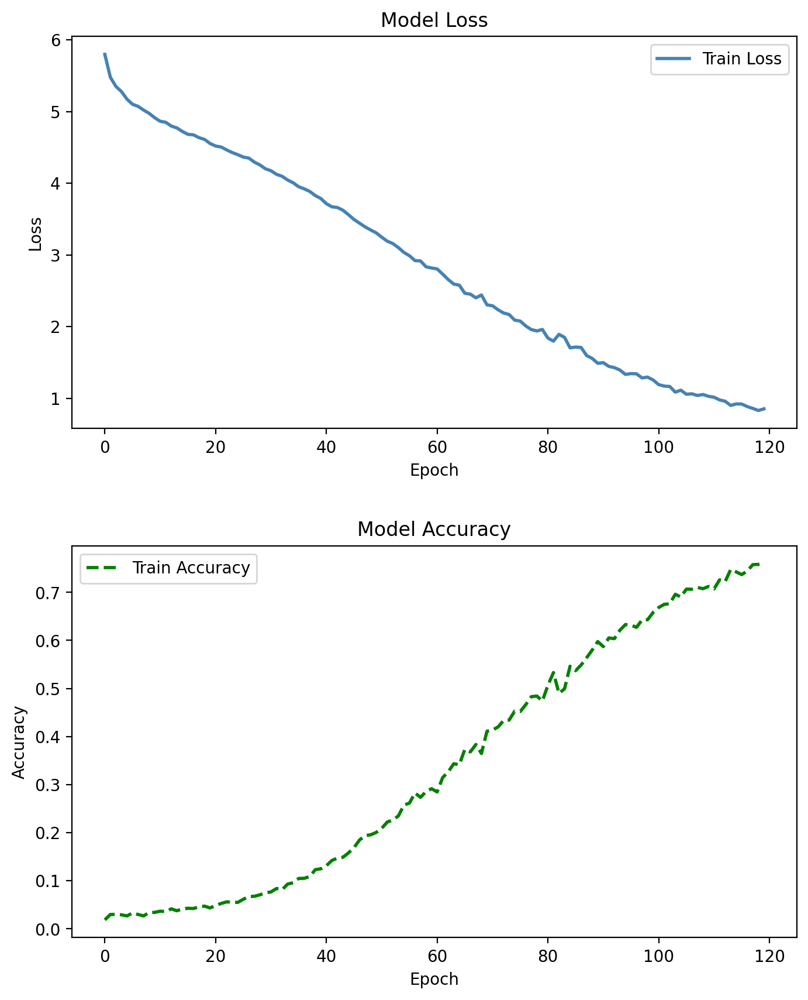

In [ ]:
train_network()

In [ ]:
#@title Generate Audio Parameters
def generate():
    ''' prepare input sequences for model to generate'''
    #load the notes used to train the model
    with open('data/notes.pkl', 'rb') as filepath:
        notes = pickle.load(filepath)

    # Get all pitch names
    pitchnames = sorted(set(item for item in notes))
    # Get all pitch names
    n_vocab = len(set(notes))

    network_input, normalized_input = prepare_sequences(notes, pitchnames, n_vocab)
    model = create_network(normalized_input, n_vocab)
    prediction_output = generate_notes(model, network_input, pitchnames, n_vocab)
    create_midi(prediction_output)

def prepare_sequences(notes, pitchnames, n_vocab):
    ''' Creating input data and target output for the model '''
    # map between notes and integers and back
    note_to_int = dict((note, number) for number, note in enumerate(pitchnames))

    sequence_length = 16
    network_input = []
    output = []
    for i in range(0, len(notes) - sequence_length, 1):
        sequence_in = notes[i:i + sequence_length]
        sequence_out = notes[i + sequence_length]
        network_input.append([note_to_int[char] for char in sequence_in])
        output.append(note_to_int[sequence_out])

    n_patterns = len(network_input)

    # reshape the input into a format compatible with LSTM layers
    normalized_input = np.reshape(network_input, (n_patterns, sequence_length, 1))
    # normalize input
    normalized_input = normalized_input / float(n_vocab)

    return (network_input, normalized_input)

def create_network(network_input, n_vocab):
    ''' creating the same model architecture for output generation'''
    model = Sequential()
    model.add(LSTM(
        512,
        input_shape=(network_input.shape[1], network_input.shape[2]),
        recurrent_dropout=0.3,
        return_sequences=True
    ))
    model.add(LSTM(512, return_sequences=True, recurrent_dropout=0.3,))
    model.add(LSTM(512))
    model.add(BatchNorm())
    model.add(Dropout(0.3))
    model.add(Dense(256))
    model.add(Activation('relu'))
    model.add(BatchNorm())
    model.add(Dropout(0.3))
    model.add(Dense(n_vocab))
    model.add(Activation('softmax'))
    model.compile(loss='categorical_crossentropy', optimizer='adam')


    directory = "/content/music_cp" #directory that contains trained weights
    file_pattern = "120"  # Specify the desired pattern to match the file name

    matched_file = None

    for file in os.listdir(directory):
        if file.endswith(".hdf5") and file_pattern in file:
            matched_file = os.path.join(directory, file)
            break

    # Load the weights to each node
    model.load_weights(matched_file) 

    return model

def generate_notes(model, network_input, pitchnames, n_vocab):
    ''' Generate Musical notes'''
    # pick a random sequence from the input as a starting point for the prediction
    start = 2717 #@param {type:"slider", min:1, max:4492, step:1}
    int_to_note = dict((number, note) for number, note in enumerate(pitchnames))

    pattern = network_input[start]
    prediction_output = []

    for note_index in range(75):
        prediction_input = np.reshape(pattern, (1, len(pattern), 1))
        prediction_input = prediction_input / float(n_vocab)



        temperature = 0.2  # Set temperature value for controlling the randomness of the generated predictions
        prediction = model.predict(prediction_input, verbose=0) # Use the trained model to make predictions
        prediction = np.log(prediction) / temperature # Adjust the prediction probabilities
        prediction = np.exp(prediction) / np.sum(np.exp(prediction)) # Normalize the probabilities to obtain a probability distribution
        index = np.random.choice(len(prediction[0]), p=prediction[0]) 

        result = int_to_note[index]
        prediction_output.append(result)
        pattern.append(index)
        pattern = pattern[1:len(pattern)]

    return prediction_output

def create_midi(prediction_output):
    ''' Create MIDI files  '''
    offset = 0
    output_notes = []

    # create note and chord objects based on the values generated by the model
    for pattern in prediction_output:
        # pattern is a chord
        if ('.' in pattern) or pattern.isdigit():
            notes_in_chord = pattern.split('.')
            notes = []
            for current_note in notes_in_chord:
                new_note = note.Note(int(current_note))
                new_note.storedInstrument = instrument.Piano()
                notes.append(new_note)
            new_chord = chord.Chord(notes)
            new_chord.offset = offset
            new_chord.volume.velocity = 50
            output_notes.append(new_chord)
        # pattern is a note
        else:
            new_note = note.Note(pattern)
            new_note.offset = offset
            new_note.storedInstrument = instrument.Piano()
            new_note.volume.velocity = np.random.randint(30, 60)
            output_notes.append(new_note)

        # increase offset each iteration so that notes do not stack
        offset += 0.5

    midi_stream = stream.Stream(output_notes)
    midi_stream.insert(0, tempo.MetronomeMark(number=100))
    midi_stream.write('midi', fp='output5.mid')



In [ ]:
generate()
clear_output()

Song Name Generation Model Reference : https://www.tensorflow.org/text/tutorials/text_generation

In [ ]:
#@title Packages for Song Name Generation
import tensorflow as tf
from keras.callbacks import ModelCheckpoint
from keras.utils import np_utils
import random
import sys
import subprocess

In [ ]:
path = "/content/drive/MyDrive/Dataset/SongCSV.txt"

In [ ]:
with open(path, 'rb') as f:
  text = f.read()

In [ ]:
encoding = 'utf-16'
text = text.decode(encoding)

In [ ]:
vocab = sorted(set(text))
ids_from_chars = tf.keras.layers.StringLookup(
    vocabulary=list(vocab), mask_token=None)
chars_from_ids = tf.keras.layers.StringLookup(
    vocabulary=ids_from_chars.get_vocabulary(), invert=True, mask_token=None)

def text_from_ids(ids):
  return tf.strings.reduce_join(chars_from_ids(ids), axis=-1)

In [ ]:
all_ids = ids_from_chars(tf.strings.unicode_split(text, 'UTF-8'))

In [ ]:
ids_dataset = tf.data.Dataset.from_tensor_slices(all_ids)

In [ ]:
seq_length = 100

In [ ]:
sequences = ids_dataset.batch(seq_length+1, drop_remainder=True)

In [ ]:
def split_input_target(sequence):
    input_text = sequence[:-1]
    target_text = sequence[1:]
    return input_text, target_text

In [ ]:
dataset = sequences.map(split_input_target)

In [ ]:
BATCH_SIZE = 32
BUFFER_SIZE = 10000
dataset = (
    dataset
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE, drop_remainder=True)
    .prefetch(tf.data.experimental.AUTOTUNE))


In [ ]:
# Length of the vocabulary in StringLookup Layer
vocab_size = len(ids_from_chars.get_vocabulary())

# The embedding dimension
embedding_dim = 256

# Number of RNN units
# rnn_units = 1024
rnn_units = 1024

In [ ]:
class MyModel(tf.keras.Model):
  def __init__(self, vocab_size, embedding_dim, rnn_units):
    super().__init__(self)
    self.embedding = tf.keras.layers.Embedding(vocab_size, embedding_dim)
    self.gru = tf.keras.layers.GRU(rnn_units,
                                   return_sequences=True,
                                   return_state=True)
    self.dense = tf.keras.layers.Dense(vocab_size)

  def call(self, inputs, states=None, return_state=False, training=False):
    x = inputs
    x = self.embedding(x, training=training)
    if states is None:
      states = self.gru.get_initial_state(x)
    x, states = self.gru(x, initial_state=states, training=training)
    x = self.dense(x, training=training)

    if return_state:
      return x, states
    else:
      return x

In [ ]:
model = MyModel(
    vocab_size=vocab_size,
    embedding_dim=embedding_dim,
    rnn_units=rnn_units)

In [ ]:
for input_example_batch, target_example_batch in dataset.take(1):
    example_batch_predictions = model(input_example_batch)
    print(example_batch_predictions.shape, "# (batch_size, sequence_length, vocab_size)")

(32, 100, 87) # (batch_size, sequence_length, vocab_size)


In [ ]:
model.summary()

Model: "my_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       multiple                  22272     
                                                                 
 gru (GRU)                   multiple                  3938304   
                                                                 
 dense_4 (Dense)             multiple                  89175     
                                                                 
Total params: 4,049,751
Trainable params: 4,049,751
Non-trainable params: 0
_________________________________________________________________


In [ ]:
loss = tf.losses.SparseCategoricalCrossentropy(from_logits=True)

In [ ]:
# model.compile(optimizer='adam', loss=loss)
model.compile(optimizer='adam', loss=loss, metrics=['accuracy'])

In [ ]:
# Directory where the checkpoints will be saved
checkpoint_dir = '/content/name_cp'
# Name of the checkpoint files
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt_{epoch}")

checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_prefix,
    save_weights_only=True)

In [ ]:
EPOCHS = 50

In [ ]:
history1 = model.fit(dataset, epochs=EPOCHS, callbacks=[checkpoint_callback])

Epoch 1/50
68/68 [==============================] - 7s 67ms/step - loss: 3.4414 - accuracy: 0.1826
Epoch 2/50
68/68 [==============================] - 3s 39ms/step - loss: 2.4975 - accuracy: 0.2860
Epoch 3/50
68/68 [==============================] - 3s 37ms/step - loss: 2.3412 - accuracy: 0.3186
Epoch 4/50
68/68 [==============================] - 3s 38ms/step - loss: 2.2413 - accuracy: 0.3448
Epoch 5/50
68/68 [==============================] - 3s 42ms/step - loss: 2.1522 - accuracy: 0.3705
Epoch 6/50
68/68 [==============================] - 3s 38ms/step - loss: 2.0659 - accuracy: 0.3951
Epoch 7/50
68/68 [==============================] - 3s 37ms/step - loss: 1.9769 - accuracy: 0.4208
Epoch 8/50
68/68 [==============================] - 3s 39ms/step - loss: 1.8851 - accuracy: 0.4473
Epoch 9/50
68/68 [==============================] - 3s 39ms/step - loss: 1.7914 - accuracy: 0.4743
Epoch 10/50
68/68 [==============================] - 3s 37ms/step - loss: 1.6902 - accuracy: 0.5041
Epoch 11/

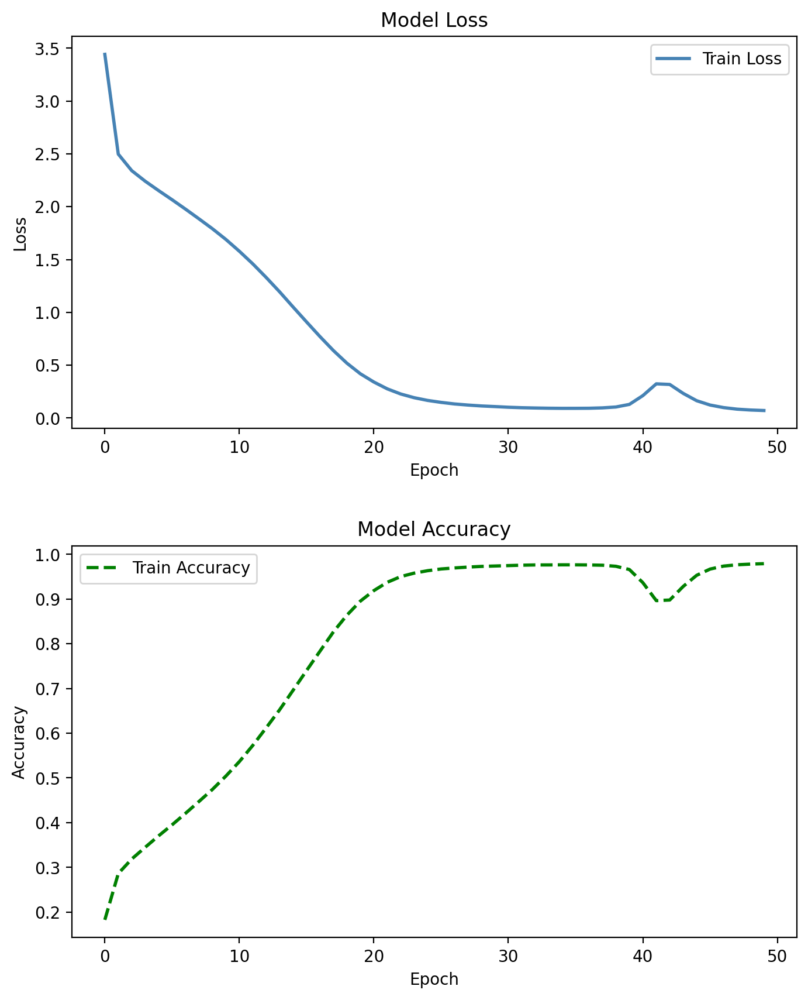

In [ ]:
# Plot training loss and validation loss in the first subplot
fig, (ax3, ax4) = plt.subplots(2, 1, figsize=(8, 10))
ax3.plot(history1.history['loss'], linestyle='-', color='steelblue', linewidth=2, label='Train Loss')
ax3.set_title('Model Loss')
ax3.set_xlabel('Epoch')
ax3.set_ylabel('Loss')
ax3.legend()

# Plot training accuracy and validation accuracy in the second subplot
ax4.plot(history1.history['accuracy'], linestyle='--', color='green', linewidth=2, label='Train Accuracy')
ax4.set_title('Model Accuracy')
ax4.set_xlabel('Epoch')
ax4.set_ylabel('Accuracy')
ax4.legend()

# Adjust spacing between subplots
plt.subplots_adjust(hspace=0.3)

# Show the two figures
plt.show()

In [ ]:
class OneStep(tf.keras.Model):
  def __init__(self, model, chars_from_ids, ids_from_chars, temperature=0.5):
    super().__init__()
    self.temperature = temperature
    self.model = model
    self.chars_from_ids = chars_from_ids
    self.ids_from_chars = ids_from_chars

    # Create a mask to prevent "[UNK]" from being generated.
    skip_ids = self.ids_from_chars(['[UNK]'])[:, None]
    sparse_mask = tf.SparseTensor(
        # Put a -inf at each bad index.
        values=[-float('inf')]*len(skip_ids),
        indices=skip_ids,
        # Match the shape to the vocabulary
        dense_shape=[len(ids_from_chars.get_vocabulary())])
    self.prediction_mask = tf.sparse.to_dense(sparse_mask)

  @tf.function
  def generate_one_step(self, inputs, states=None):
    # Convert strings to token IDs.
    input_chars = tf.strings.unicode_split(inputs, 'UTF-8')
    input_ids = self.ids_from_chars(input_chars).to_tensor()

    # Run the model.
    # predicted_logits.shape is [batch, char, next_char_logits]
    predicted_logits, states = self.model(inputs=input_ids, states=states,
                                          return_state=True)
    # Only use the last prediction.
    predicted_logits = predicted_logits[:, -1, :]
    predicted_logits = predicted_logits/self.temperature
    # Apply the prediction mask: prevent "[UNK]" from being generated.
    predicted_logits = predicted_logits + self.prediction_mask

    # Sample the output logits to generate token IDs.
    predicted_ids = tf.random.categorical(predicted_logits, num_samples=1)
    predicted_ids = tf.squeeze(predicted_ids, axis=-1)

    # Convert from token ids to characters
    predicted_chars = self.chars_from_ids(predicted_ids)

    # Return the characters and model state.
    return predicted_chars, states

In [ ]:
one_step_model = OneStep(model, chars_from_ids, ids_from_chars)

In [ ]:
#@title Installing Stable Diffusion Packages 
!pip install diffusers==0.11.1
!pip install transformers scipy ftfy accelerate

import torch
from diffusers import StableDiffusionPipeline
import ipywidgets
from IPython.display import clear_output
from PIL import Image

pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", torch_dtype=torch.float16)  
pipe = pipe.to("cuda")

# This function is used to make a grid of images, for easier viewing.

def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols
    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

clear_output()

In [ ]:
#@title Installing packages for displaying MIDI file as an audio file
from IPython.display import Audio
!pip install mido
!pip install pedalboard
from mido import MidiFile, MidiTrack, Message
!apt install fluidsynth
clear_output()

In [ ]:
def save_to_audio_file(midi_file_path: str, audio_file_path: str, soundfont_path: str) -> None:

    if soundfont_path is None:
        soundfont_path = "/content/drive/MyDrive/Dataset/Soundfonts/Motif_ES6_Concert_Piano_Realistic_Edit.sf2"

    subprocess.run(["fluidsynth", "-ni", soundfont_path, midi_file_path, "-F", audio_file_path, "-r", "44100"], stdout=subprocess.DEVNULL, stderr=subprocess.DEVNULL)

In [ ]:
save_to_audio_file("/content/output1.mid","/content/audio1.wav", "/content/drive/MyDrive/Dataset/Soundfonts/Motif_ES6_Concert_Piano_Realistic_Edit.sf2" )

In [ ]:
save_to_audio_file("/content/output2.mid","/content/audio2.wav", "/content/drive/MyDrive/Dataset/Soundfonts/Motif_ES6_Concert_Piano_Realistic_Edit.sf2" )

In [ ]:
save_to_audio_file("/content/output3.mid","/content/audio3.wav", "/content/drive/MyDrive/Dataset/Soundfonts/Motif_ES6_Concert_Piano_Realistic_Edit.sf2" )

In [ ]:
save_to_audio_file("/content/output4.mid","/content/audio4.wav", "/content/drive/MyDrive/Dataset/Soundfonts/Motif_ES6_Concert_Piano_Realistic_Edit.sf2")

In [ ]:
save_to_audio_file("/content/output5.mid","/content/audio5.wav", "/content/drive/MyDrive/Dataset/Soundfonts/Motif_ES6_Concert_Piano_Realistic_Edit.sf2" )

In [ ]:
#source - https://github.com/spotify/pedalboard
from pedalboard import Pedalboard, Chorus, Reverb, Delay
from pedalboard.io import AudioFile

# Make a Pedalboard object, containing multiple audio plugins:
board = Pedalboard([Chorus(),Delay(delay_seconds=0.2, mix=1.0), Reverb(room_size=0.5)])

# Open an audio file for reading, just like a regular file:
with AudioFile('/content/audio5.wav') as f:
  
  # Open an audio file to write to:
  with AudioFile('Rev_output5.wav', 'w', f.samplerate, f.num_channels) as o:
    while f.tell() < f.frames:
      chunk = f.read(int(f.samplerate))
      effected = board(chunk, f.samplerate, reset=False)
      o.write(effected)

In [ ]:
audio_file_path = "/content/Rev_output1.wav"
Audio(audio_file_path)

In [ ]:
audio_file_path = "/content/Rev_output2.wav"
Audio(audio_file_path)

In [ ]:
audio_file_path = "/content/Rev_output3.wav"
Audio(audio_file_path)

In [ ]:
audio_file_path = "/content/Rev_output4.wav"
Audio(audio_file_path)

In [ ]:
audio_file_path = "/content/Rev_output5.wav"
Audio(audio_file_path)

In [ ]:
#@title ## Name Generator
#@markdown Enter first few characters of the Song Name
states = None

name = "Brother " #@param {type:"string"} 
next_char = tf.constant([name])
result = [next_char]

for n in range(100):
  next_char, states = one_step_model.generate_one_step(next_char, states=states)
  result.append(next_char)

result = tf.strings.join(result)
s_name = result[0].numpy().decode('utf-8').split(".")
s_name = (s_name[0].split("\r"))[0]
print(s_name)


Brother Trance Vol


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

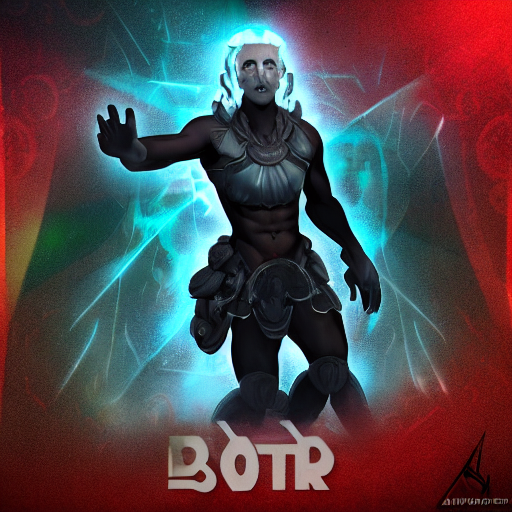

In [ ]:
#@title Generate Album art
content = s_name
extra = "Trending on ArtStation" #@param ["Trending on ArtStation", "4k ultra realistic", "Concept art", "Key Visual", "3D model"]
prompt = f"{content}. {extra}"
pipeline_output = pipe(prompt)
prompt_array = [prompt] 

pipeline_output = pipe(prompt_array, width=512, height=512)
images = pipeline_output.images

display(image_grid(images, rows=1, cols=1))